# Image Preprocessing Notebook

In [1]:
import cv2
from pathlib import Path
import matplotlib.pyplot as plt
import os
import numpy as np

In [2]:
def read_images():
    base_path = "./test_images"
    images = {}
    for subdir, dirs, files in os.walk(base_path):
            for index, image in enumerate(files):
                path = os.path.join(base_path, image)
                img = cv2.imread(path)
                images[image[:-7]] = img
    return images

def plot_img(orignal, processed, ax):
    #plot original image
    ax[0].set_title("original")
    ax[0].imshow(cv2.cvtColor(orignal, cv2.COLOR_BGR2RGB))
    
    #plot processed image
    ax[1].set_title("processed")
    ax[1].imshow(cv2.cvtColor(processed, cv2.COLOR_BGR2RGB))
    
    
def show_images(orig_images, processed_images):
    fig, ax = plt.subplots(10,2,figsize=(15,100))
    for i in range(10):
        plot_img(orig_images[i], processed_images[i],ax[i])
    plt.show()
    
def show_image(img_orig, img_processed, edged_img = 0):
    fig, ax = plt.subplots(1,2, figsize=(15,15))
    
    ax[0].set_title("original")
    ax[0].imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
    
    #plot processed image
    if edged_img == 0:
        ax[1].set_title("processed")
        ax[1].imshow(cv2.cvtColor(img_processed, cv2.COLOR_BGR2RGB))
    else:
        ax[1].set_title("processed")
        ax[1].imshow(img_processed,cmap = 'gray')
    plt.show()
    

In [3]:
image_dict = read_images()
images_orig = list(image_dict.values())

## 1. Color spaces

Read in Grayscale

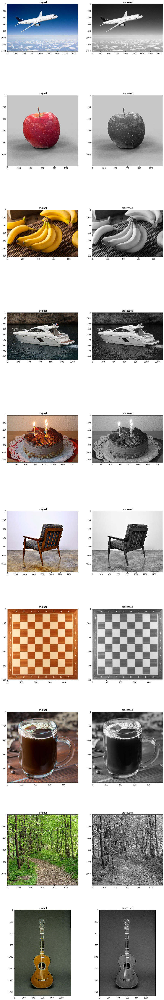

In [4]:
def cvt_gray(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

images_gray = list(map(cvt_gray, images_orig))
show_images(images_orig, images_gray)

Read in HSV

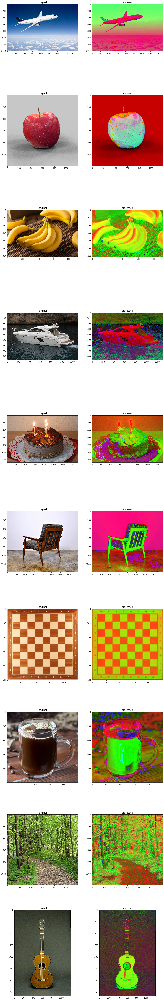

In [6]:
def cvt_hsv(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

images_hsv = list(map(cvt_hsv, images_orig))
show_images(images_orig, images_hsv)

## 2. Sharpening

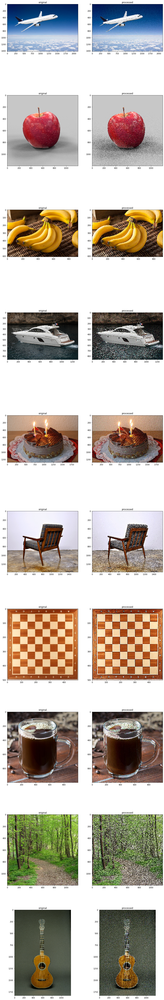

In [7]:
def sharpen_img(img):
    kernel_sharpening = np.array([[-1,-1,-1], 
                                  [-1,9,-1], 
                                  [-1,-1,-1]])

    # applying different kernels to the input image
    return cv2.filter2D(img, -1, kernel_sharpening)

images_sharpened = list(map(sharpen_img, images_orig))
show_images(images_orig, images_sharpened)

## 3. Thresholding

Adaptive Thresholding - use it when its difficult to decide the threshold value, it will calculate the threshold value smarlty using the neighbourhood mean values and others.

In [8]:
def threshold_img(img, method = "binary", blur_technique = "median"):
    #thresholding works only on gray images
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    #good practice to blur images to remove noise
    if blur_technique == "median":
        blur_img = cv2.medianBlur(gray_img,5)
    else:
        blur_img = cv2.GaussianBlur(gray_img,(5,5),0)
        
    #otsu is a popular one.
    if method == "otsu":
        return cv2.threshold(blur_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
    elif method == "adaptive_mean":
        return cv2.adaptiveThreshold(blur_img,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,2)
    elif method == "adaptive_gaussian":
        return cv2.adaptiveThreshold(blur_img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    else:
        #simple binary thresholding, there are other variants as well
        return cv2.threshold(blur_img,127,255,cv2.THRESH_BINARY)[1]

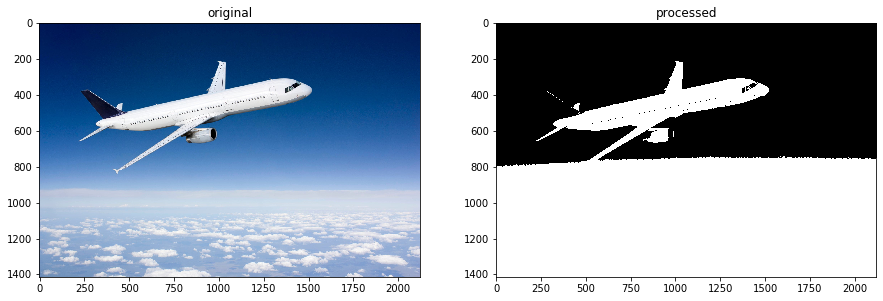

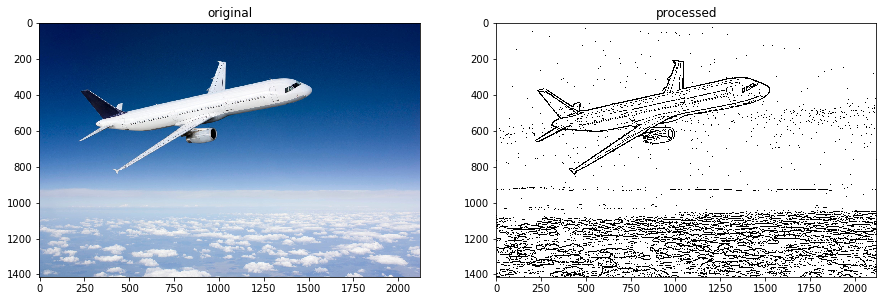

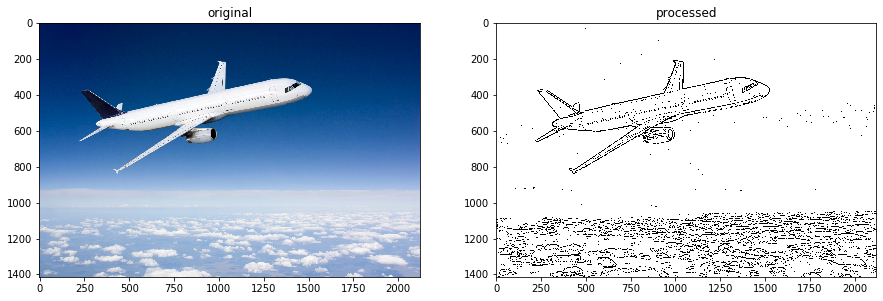

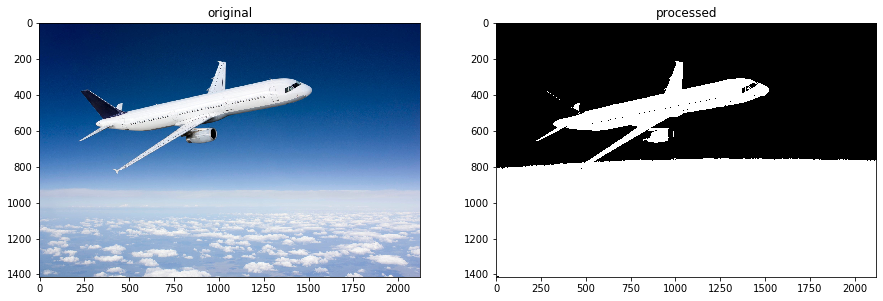

In [9]:
img_processed = threshold_img(images_orig[0], "otsu")
show_image(images_orig[0], img_processed)

img_processed = threshold_img(images_orig[0], "adaptive_mean")
show_image(images_orig[0], img_processed)

img_processed = threshold_img(images_orig[0], "adaptive_gaussian")
show_image(images_orig[0], img_processed)

img_processed = threshold_img(images_orig[0])
show_image(images_orig[0], img_processed)

## 4. Geometric Transformations

Scale/Resize

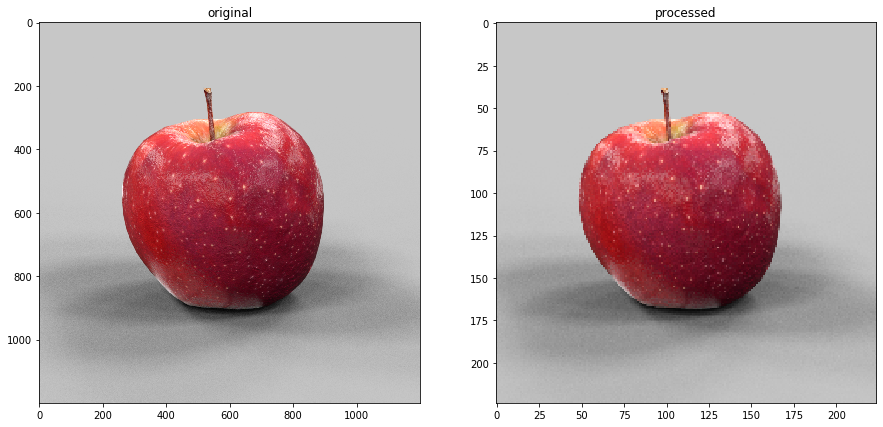

In [10]:
def resize_img(img, dim):
    #check upscaling or downscaling
    if img.shape[0] > dim[0] & img.shape[1] > dim[1]:
        #downscaling/shrinking
        return cv2.resize(img,dim, interpolation = cv2.INTER_AREA)
    else:
        #upscaling/zooming
        return cv2.resize(img,dim, interpolation = cv2.INTER_LINEAR)
    
img_processed = resize_img(images_orig[1], (224, 224))
show_image(images_orig[1], img_processed)

Translation

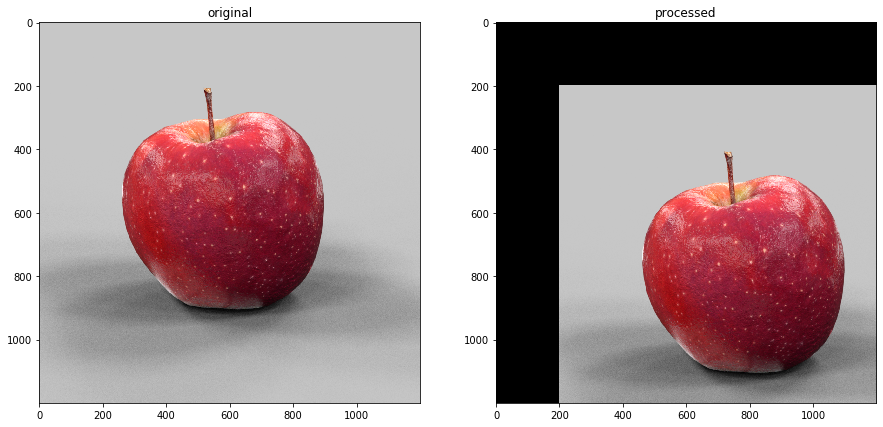

In [11]:
def translate_img(img, shift_x, shift_y):
    rows,cols = img.shape[:2]
    M = np.float32([[1,0,shift_x],[0,1,shift_y]])
    #here cols and rows are the dimension of output image
    return cv2.warpAffine(img,M,(cols,rows))

img_processed = translate_img(images_orig[1], 200, 200)
show_image(images_orig[1], img_processed)

Rotations

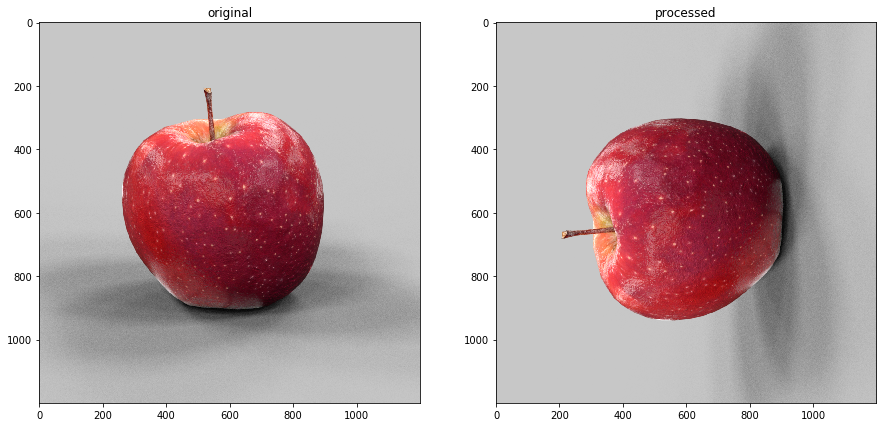

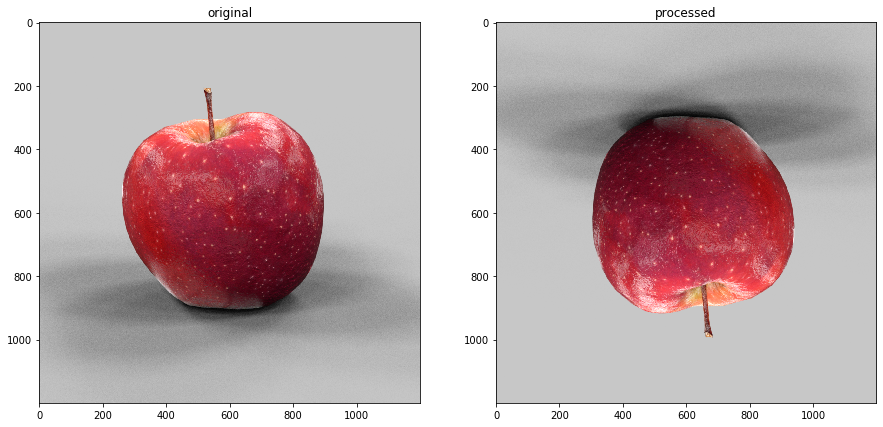

In [12]:
def rotate_img(img, degree):
    rows,cols = img.shape[:2]
    M = cv2.getRotationMatrix2D((cols/2,rows/2),degree,1)
    return cv2.warpAffine(img,M,(cols,rows))

img_processed = rotate_img(images_orig[1], 90)
show_image(images_orig[1], img_processed)

img_processed = rotate_img(images_orig[1], 180)
show_image(images_orig[1], img_processed)

Affine Transforms

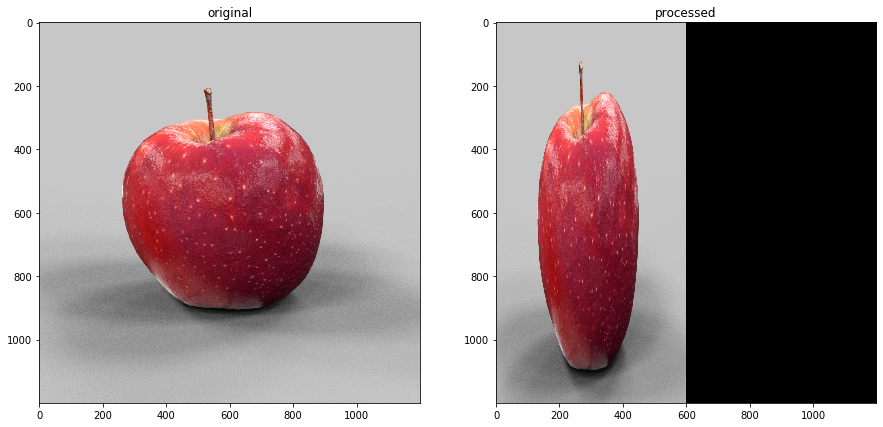

In [13]:
#need 3 input points and corresponding output points
def affine_transform_img(img, input_points, output_points):
    rows,cols,ch = img.shape

    pts1 = np.float32(input_points)
    pts2 = np.float32(output_points)

    M = cv2.getAffineTransform(pts1,pts2)

    return cv2.warpAffine(img,M,(cols,rows))

img_processed = affine_transform_img(images_orig[1], [[0, 100], [0, 600], [800, 700]], 
                                     [[0, 0], [0, 700], [400, 800]])
show_image(images_orig[1], img_processed)

Perspective Transform

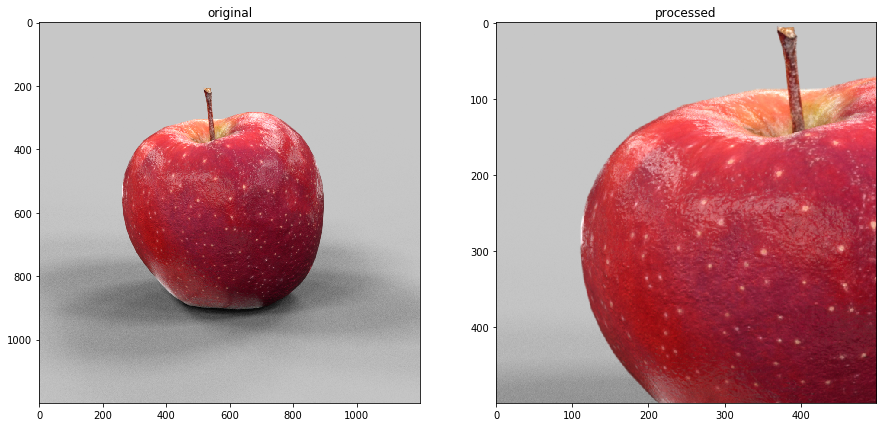

In [14]:
#need 4 input points and corresponding output points
def perspective_transform_img(img, input_points, output_points):
    pts1 = np.float32(input_points)
    pts2 = np.float32(output_points)

    M = cv2.getPerspectiveTransform(pts1,pts2)

    return cv2.warpPerspective(img,M,(500,500))

img_processed = perspective_transform_img(images_orig[1], [[150,200],[650, 200],[150,800],[650,800]], 
                                     [[0,0],[500,0],[0,500],[500,500]])
show_image(images_orig[1], img_processed)

## 5. Smoothing/Blurring i.e removing noise

In [15]:
def denoise_img(img, method="fastNl", kernel_size=5):
    if method == "median":
        return cv2.medianBlur(img,kernel_size)
    elif method == "gaussian":
        return cv2.GaussianBlur(img,(kernel_size,kernel_size),0)
    elif method == "average":
        return cv2.blur(img,(kernel_size,kernel_size))
    elif method == "bilateral":
        return cv2.bilateralFilter(img,kernel_size,75,75)
    else:
        return cv2.fastNlMeansDenoisingColored(img, None, 7, 21, 10, 10)

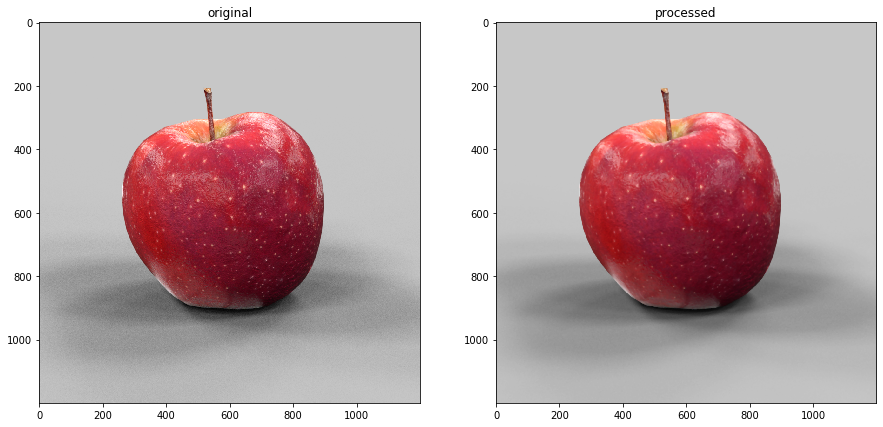

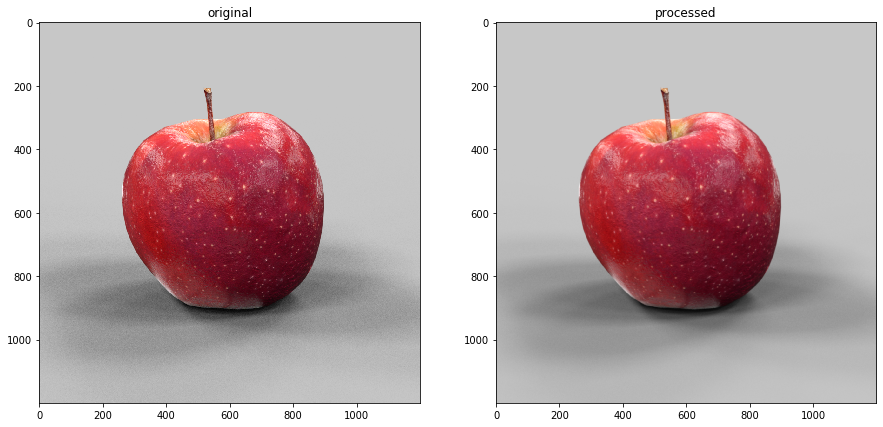

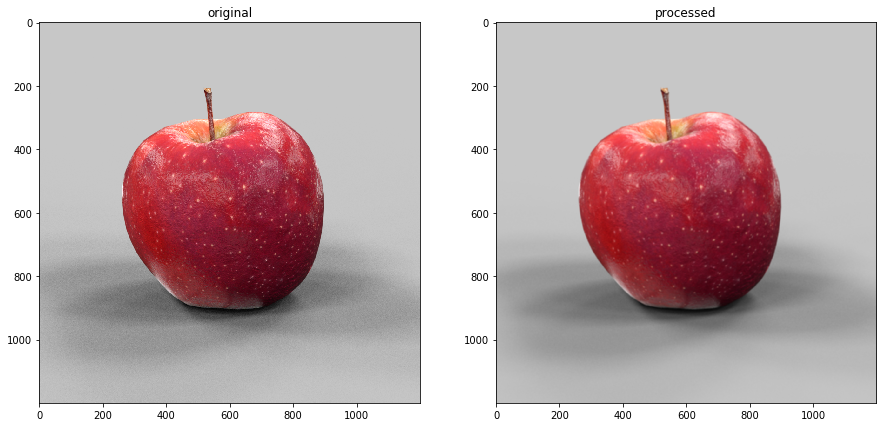

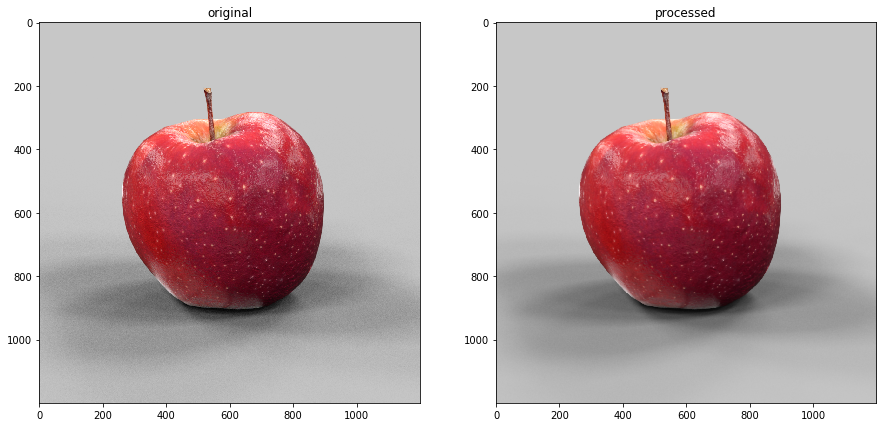

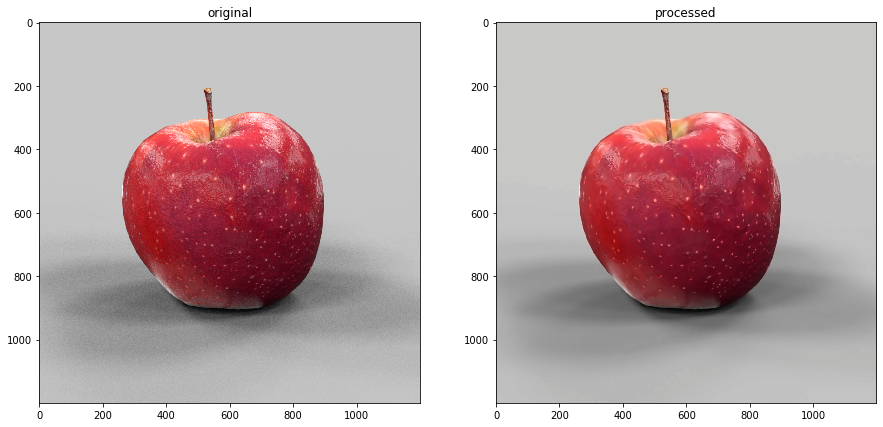

In [16]:
img_processed = denoise_img(images_orig[1], "median")
show_image(images_orig[1], img_processed)

img_processed = denoise_img(images_orig[1], "gaussian")
show_image(images_orig[1], img_processed)

img_processed = denoise_img(images_orig[1], "average")
show_image(images_orig[1], img_processed)

img_processed = denoise_img(images_orig[1], "bilateral")
show_image(images_orig[1], img_processed)

img_processed = denoise_img(images_orig[1])
show_image(images_orig[1], img_processed)

## 6. Morphological Transformations

Erosions and dilations are the basic ones and Opening, Closing and Gradient are their variations

In [17]:
def morph_transform_img(img, method = "gradient", kernel_size=5):
    kernel = np.ones((kernel_size,kernel_size),np.uint8)
    if method == "erosion":
        return cv2.erode(img, kernel,iterations = 1)
    elif method == "dilation":
        return cv2.dilate(img,kernel,iterations = 1)
    elif method == "closing":
        return cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
    elif method == "opening":
        return cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
    else:
        return cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)

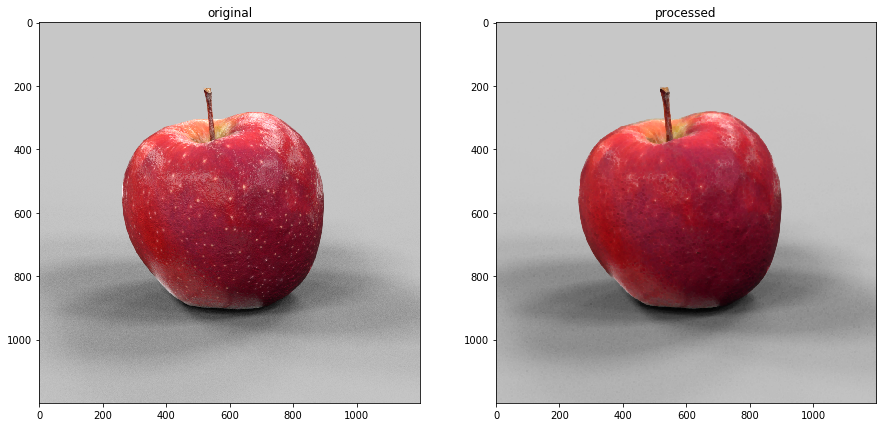

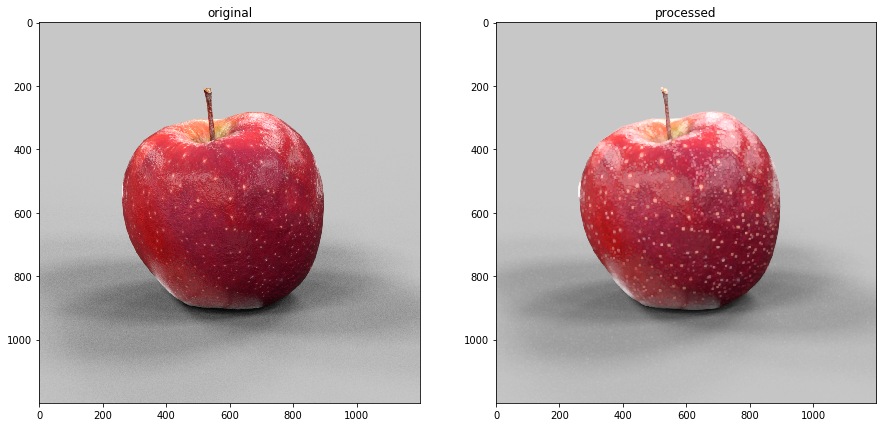

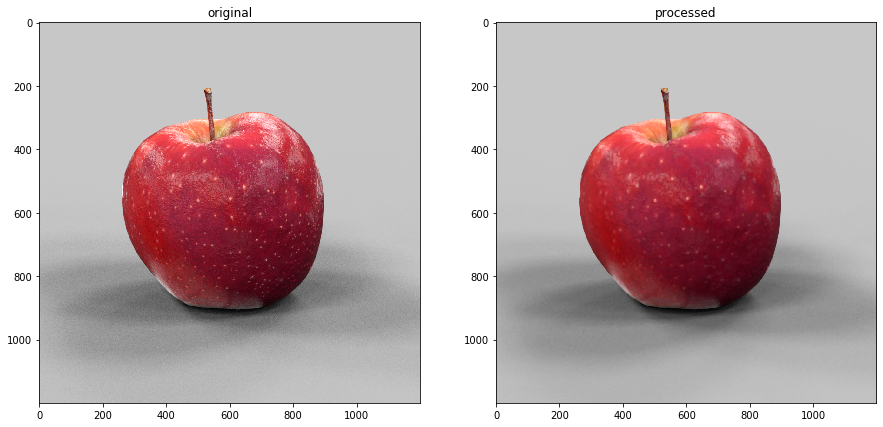

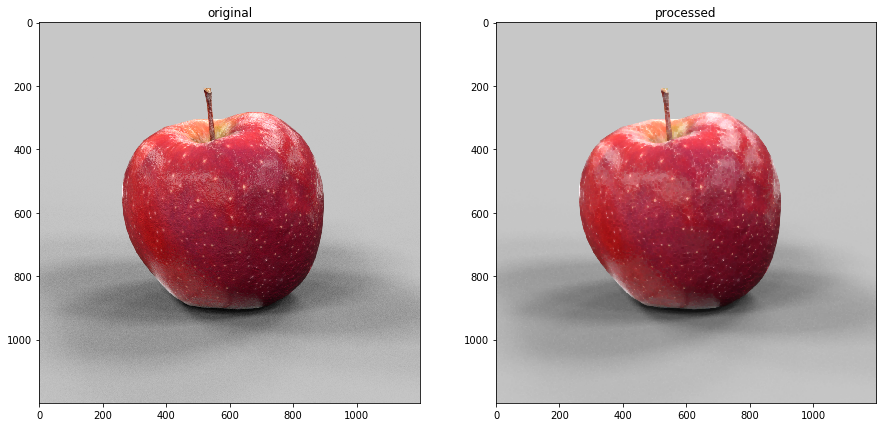

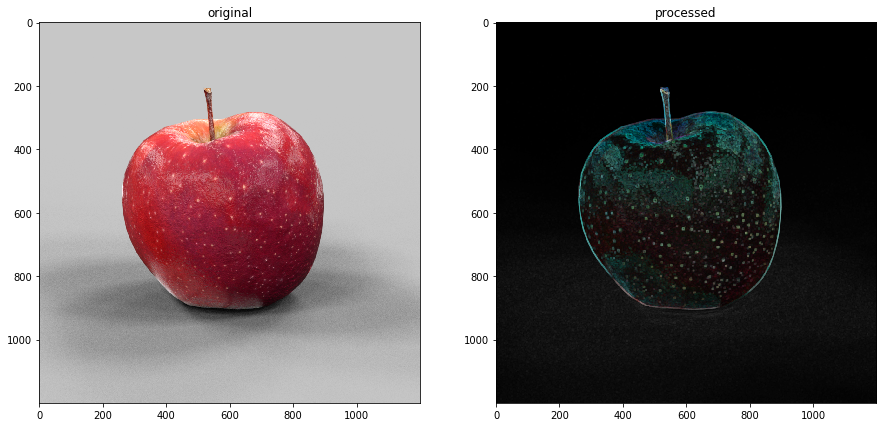

In [18]:
img_processed = morph_transform_img(images_orig[1], "erosion")
show_image(images_orig[1], img_processed)

img_processed = morph_transform_img(images_orig[1], "dilation")
show_image(images_orig[1], img_processed)

img_processed = morph_transform_img(images_orig[1], "closing")
show_image(images_orig[1], img_processed)

img_processed = morph_transform_img(images_orig[1], "opening")
show_image(images_orig[1], img_processed)

img_processed = morph_transform_img(images_orig[1])
show_image(images_orig[1], img_processed)

## 7. Image Gradients
High Pass filters - Sobel, Scharr, Laplacian

In [35]:
def edge_detection(img, method = "canny", kernel_size = 5):
    if len(thres_img.shape) > 2:
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    if method == "sobel":
        sobel_x = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=kernel_size)
        sobel_y = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=kernel_size)
        sobel_OR = cv2.bitwise_or(sobel_x, sobel_y)
        return sobel_OR
    elif method == "laplacian":
        return cv2.Laplacian(img,cv2.CV_64F)
    else:
        return cv2.Canny(img,100,200)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\cm.py:274: RuntimeWarning: invalid value encountered in multiply
  xx = (xx * 255).astype(np.uint8)


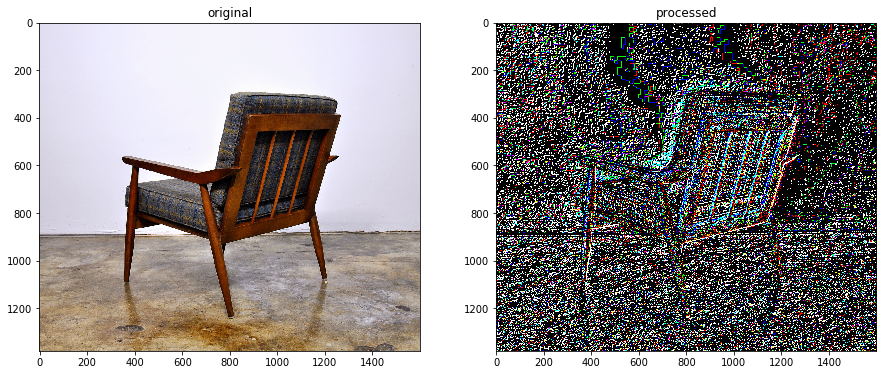

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


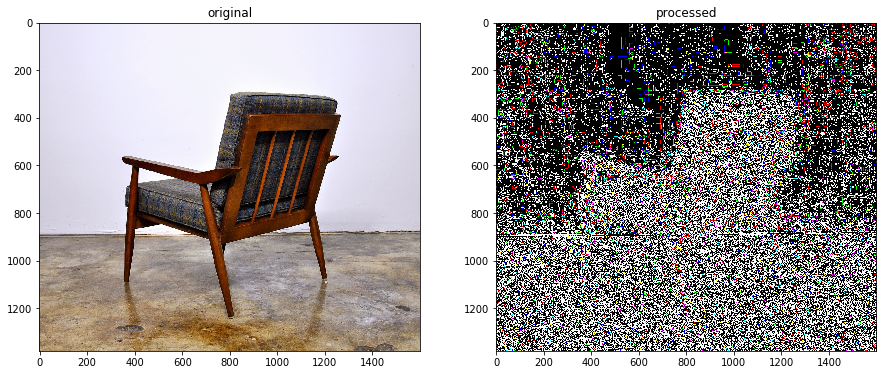

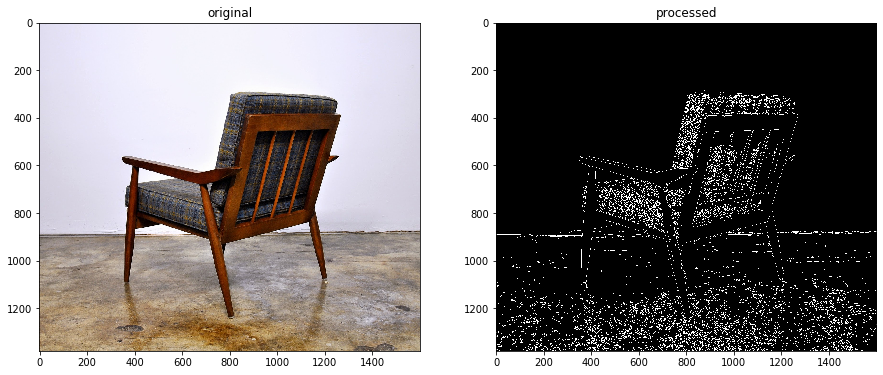

In [20]:
img_processed = edge_detection(images_orig[5], "sobel")
show_image(images_orig[5], img_processed, 1)

img_processed = edge_detection(images_orig[5], "laplacian")
show_image(images_orig[5], img_processed, 1)

img_processed = edge_detection(images_orig[5])
show_image(images_orig[5], img_processed, 1)

### Experiments

In [30]:
len(thres_img.shape)

2

In [28]:
test_img.shape

(1200, 1200, 3)

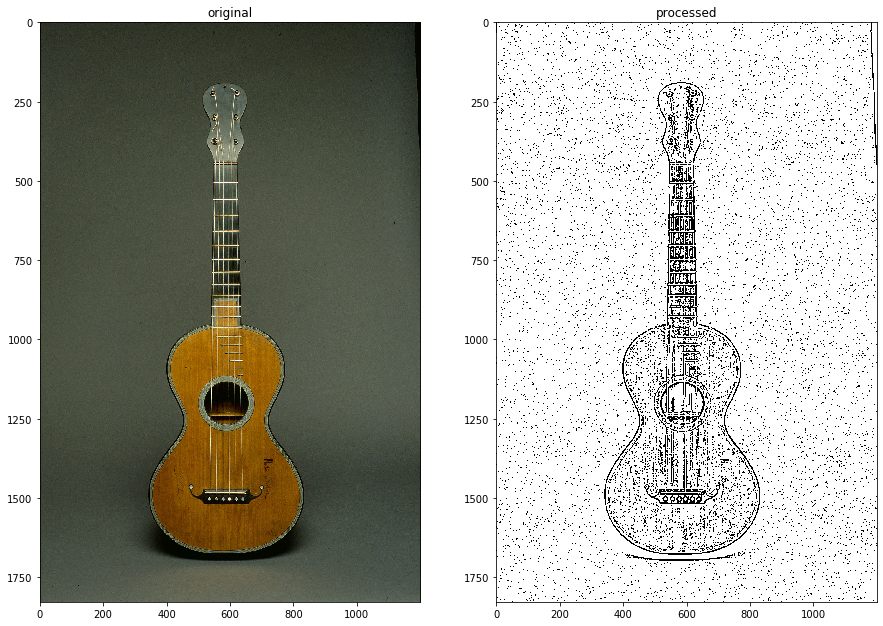

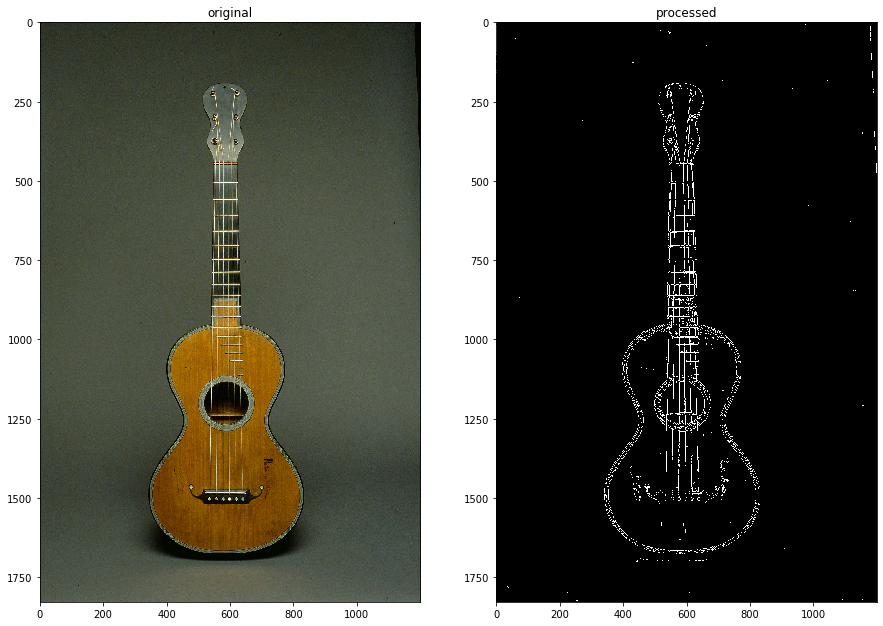

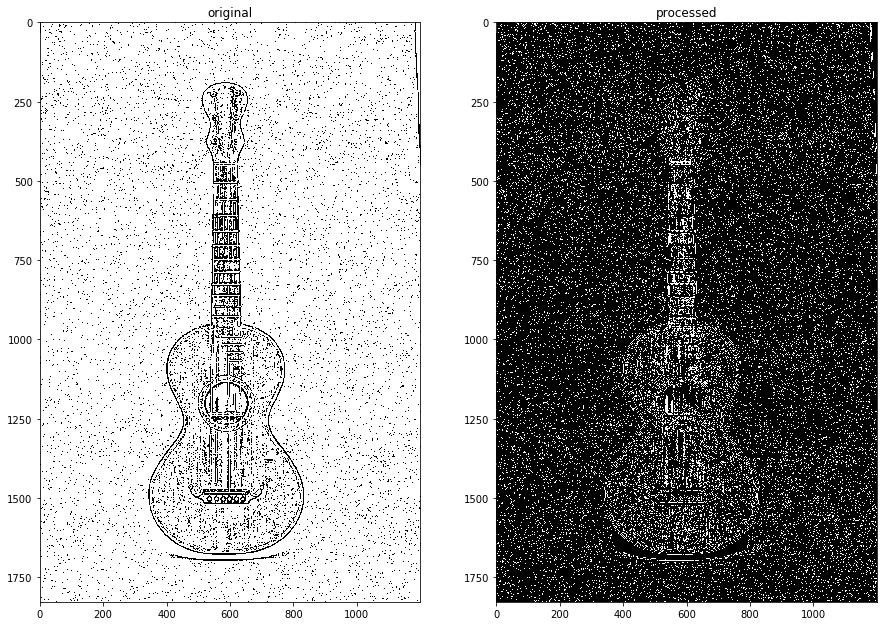

In [50]:
test_img = images_orig[9]

thres_img = threshold_img(test_img, "adaptive_gaussian")
show_image(test_img, thres_img)

edge_img = edge_detection(test_img)
show_image(test_img, edge_img)

edge_img = edge_detection(thres_img)
show_image(thres_img, edge_img)